In [25]:
# Will reload modeules after this when they change!
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [72]:
import pandas as pd
import numpy as np
import os
from IPython.display import Image

# Standard plotly imports
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode

# Using plotly + cufflinks in offline mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)

# Seaborn instead
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import warnings
from exploratory_data_analysis import *

def action_with_warnings():
    warnings.warn("should not appear")

### This script 
1. G

### To do:
5. nl_04 

### Observations:
1. 2

# Loads pickles from:
http://localhost:8888/notebooks/PycharmProjects/neutral_loss/nl_0_3_clean_join_nb.ipynb

In [190]:
data_df = pd.read_pickle('high_quality.pickle')
db_df = pd.read_pickle('/Users/dis/PycharmProjects/neutral_loss/databases/core_metabolome_out.pickle') 
mord_norm_df = pd.read_pickle('/Users/dis/PycharmProjects/neutral_loss/databases/mord_norm_df.pickle') 
morg_df = pd.read_pickle('/Users/dis/PycharmProjects/neutral_loss/databases/bits_df.pickle')
dfs = [db_df, mord_norm_df, morg_df]

In [55]:
# Adding four main data catagories:
data_df['fourX'] = data_df['analyzer'] + data_df['polarity']

# FDR filtering: 
data_df = data_df[~data_df.fdr.isin([0.2, 0.5])]
data_df.fdr.unique()

array([0.05, 0.1 ,  nan])

In [56]:
list(data_df)

['formula',
 'adduct',
 'ds_id',
 'has_no_loss',
 'has_H2O',
 'msm',
 'fdr',
 'off_sample',
 'hmdb_ids',
 'intensity_avg',
 'msm_H2O',
 'fdr_H2O',
 'off_sample_H2O',
 'intensity_avg_H2O',
 'colocalization_H2O',
 'loss_intensity_ratio_H2O',
 'loss_intensity_share_H2O',
 'ion',
 'ion_H2O',
 'ion_formula',
 'ion_formula_H2O',
 'group',
 'analyzer',
 'polarity',
 'FDR10-v4',
 'fourX']

In [38]:
# Barplot example
df = data_df[['has_no_loss', 'has_H2O']].iloc[0:20,:]
df.T.iplot(kind='bar')

In [41]:
# Histogram example
col = 'formula'
data_df[col].iplot(kind='hist', xTitle=col, yTitle='count',
                      title=str(str(col) + ' counts'))

In [52]:
# Multiple histogram example
cols = ['formula', 'ds_id']
df = data_df[cols]
fig = df.iplot(kind='histogram', subplots=True, shape=(1,2))

In [54]:
# Multiple histogram example
cols = ['analyzer', 'polarity', 'group']
df = data_df[cols]
fig = df.iplot(kind='histogram', subplots=True, shape=(3,1))

In [22]:
# Box plot example
data_df[['fdr', 'msm', 'colocalization_H2O']].iplot(kind='box')

In [70]:
# Groupby boxplot
df = data_df[['fourX', 'msm']]
df.pivot(columns='fourX', values='msm').iplot(kind='box')

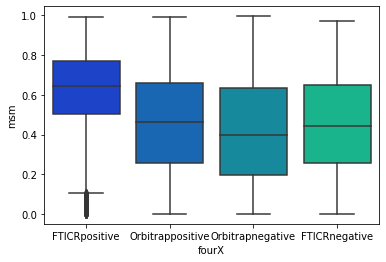

In [77]:
# Groupby boxplot
# Much quicker!
df = data_df[['fourX', 'msm']]
sns.boxplot(x='fourX', y='msm', data=df, palette='winter')

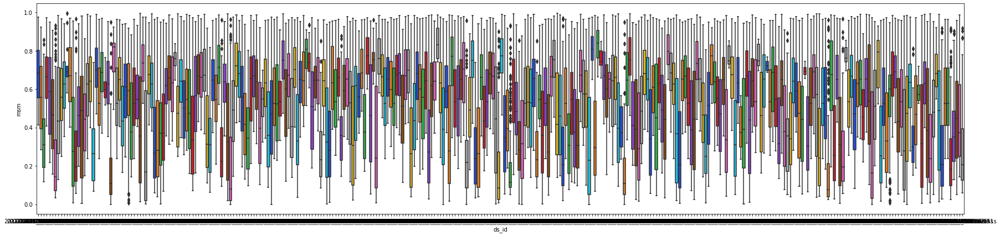

In [81]:
df = data_df[['ds_id', 'msm']]
plt.figure(figsize=(30, 7))
sns.boxplot(x='ds_id', y='msm', data=df, palette='bright')

In [60]:
# Scatter plot
df = data_df[(data_df.analyzer=='FTICR')&(data_df.polarity=='positive')]
df = df[['msm', 'intensity_avg']]
df.iplot(kind='scatter', mode='markers', x='msm', y='intensity_avg',
        xTitle='msm', yTitle='intensity', title='FT+: Intensity vs msm')

In [82]:
# Scatter plot
df = data_df[['msm', 'intensity_avg', 'fourX']]

for f in df.fourX.unique():
    df = data_df[data_df.fourX==f]
    df.iplot(kind='scatter', mode='markers', x='msm', y='intensity_avg',
             xTitle='msm', yTitle='intensity', title=str(f + " Itensity vs msm"))

SyntaxError: invalid syntax (<ipython-input-82-3fbe83dbd7ec>, line 4)

In [132]:
df.fourX.unique()

array(['FTICRpositive', 'Orbitrappositive', 'Orbitrapnegative',
       'FTICRnegative'], dtype=object)

In [173]:
# Heatmap
df = data_df[['fourX', 'group', 'fdr']]
df = df.groupby(['fourX', 'group']).count()
df = df.unstack().fillna(0)
df

fdr                                                      \
group              HMGU    IBMP MPI Bremen    PNNL U Copenhagen U Melbourne   
fourX                                                                         
FTICRnegative     432.0     0.0        0.0    97.0          0.0      3685.0   
FTICRpositive       0.0  4720.0        0.0  1747.0          0.0      1030.0   
Orbitrapnegative    0.0     0.0        0.0     0.0       1758.0         0.0   
Orbitrappositive    0.0     0.0     2820.0     0.0          0.0         0.0   

                                             
group            U Rennes 1   UTHSA  ♡EMBL♡  
fourX                                        
FTICRnegative         142.0     0.0     0.0  
FTICRpositive       20638.0     0.0     0.0  
Orbitrapnegative        0.0  4151.0  4678.0  
Orbitrappositive        0.0  8319.0  2763.0

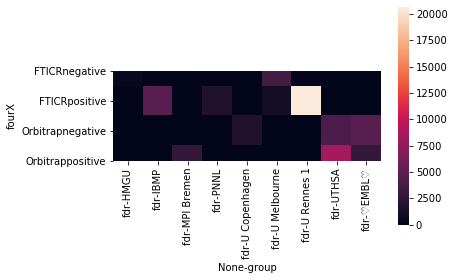

In [172]:
ax = sns.heatmap(df, square=True)

In [180]:
# Heatmap
#df = data_df[data_df.fourX == 'Orbitrappositive']
df = data_df[['ds_id', 'group', 'formula']]
df = df.groupby(['ds_id', 'group']).count()
df = df.unstack().fillna(0)
df

formula                                                  \
group                   HMGU IBMP MPI Bremen   PNNL U Copenhagen U Melbourne   
ds_id                                                                          
2016-09-22_11h16m11s     0.0  0.0        0.0    0.0          0.0         0.0   
2016-09-22_11h16m15s     0.0  0.0        0.0    0.0          0.0         0.0   
2016-09-22_11h16m16s     0.0  0.0        0.0    0.0          0.0         0.0   
2016-09-22_11h16m23s     0.0  0.0        0.0    0.0          0.0         0.0   
2016-09-22_11h16m27s     0.0  0.0        0.0    0.0          0.0         0.0   
...                      ...  ...        ...    ...          ...         ...   
2019-10-29_21h29m01s     0.0  0.0        0.0    0.0          0.0         0.0   
2019-10-29_21h37m26s     0.0  0.0        0.0    0.0          0.0         0.0   
2019-11-15_20h49m52s     0.0  0.0        0.0    0.0          0.0         0.0   
2019-11-15_20h55m40s     0.0  0.0        0.0    0.0          0.0         0.0   
2019-12-04_00h41m47s     0.0  0.0        0.0  768.0          0.0         0.0   

                                               
group                U Rennes 1  UTHSA ♡EMBL♡  
ds_id                                          
2016-09-22_11h16m11s      213.0    0.0    0.0  
2016-09-22_11h16m15s      423.0    0.0    0.0  
2016-09-22_11h16m16s      221.0    0.0    0.0  
2016-09-22_11h16m23s      284.0    0.0    0.0  
2016-09-22_11h16m27s      316.0    0.0    0.0  
...                         ...    ...    ...  
2019-10-29_21h29m01s        0.0  222.0    0.0  
2019-10-29_21h37m26s        0.0  201.0    0.0  
2019-11-15_20h49m52s        0.0  215.0    0.0  
2019-11-15_20h55m40s        0.0  236.0    0.0  
2019-12-04_00h41m47s        0.0    0.0    0.0  

[318 rows x 9 columns]

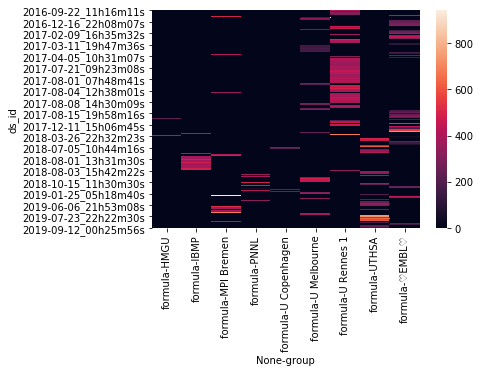

In [181]:
ax = sns.heatmap(df)

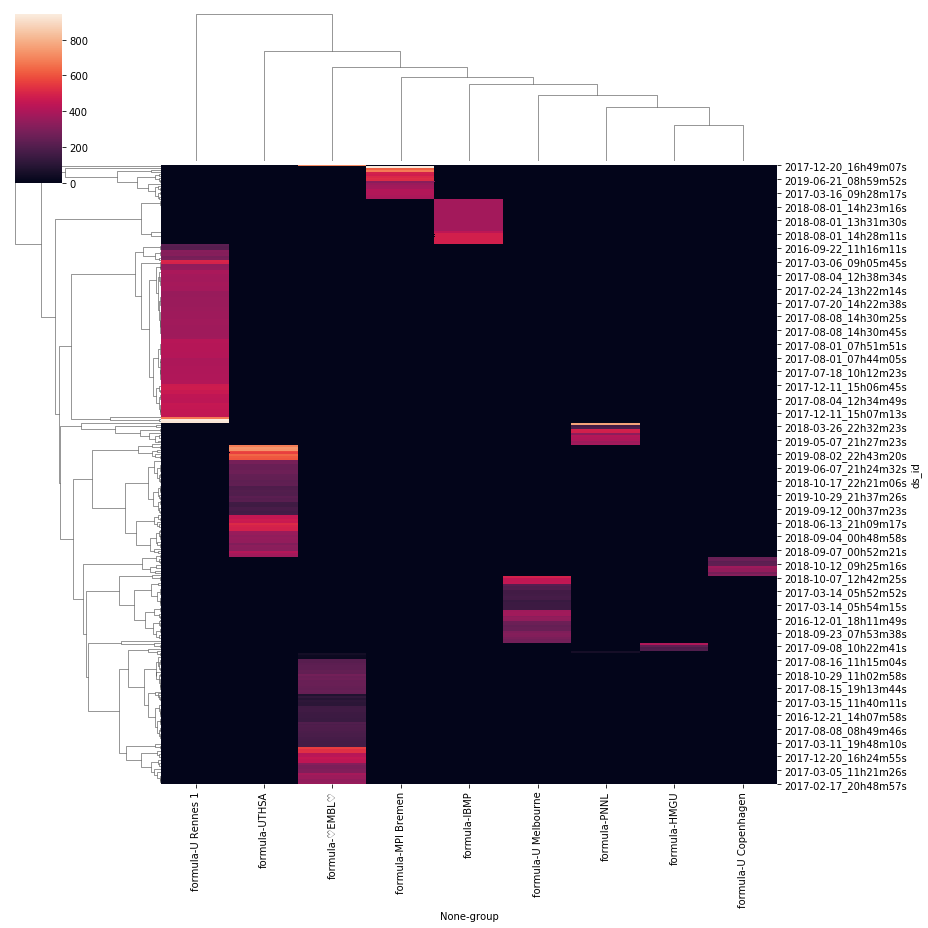

In [187]:
ax = sns.clustermap(df, figsize=(13, 13))

In [ ]:
# master(data_df: df, dfs: [dfs], 
#            mord_bool, morg_bool, expt_only: bool
#           dim_red: ['umap', 'pca', 'none'] 
#           data_sort: ['all', '4x', 'group', 'ds_id']  
#           title: str, n: int 
#           color: 
#   plot_type: ['scatter', 'scatterplot_matrix', 'h_cluster', 'violin_plot', 'none'

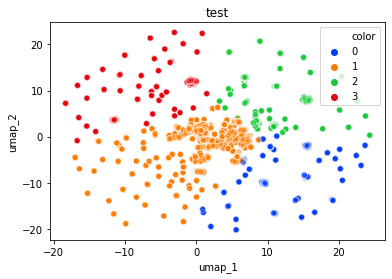

In [149]:
# Morgan all db umap
with warnings.catch_warnings(record=True):
    action_with_warnings()
    x = master(data_df, dfs, False, True, False,
               'umap', 'all', 'test', 4, 'kmeans', 'scatter')

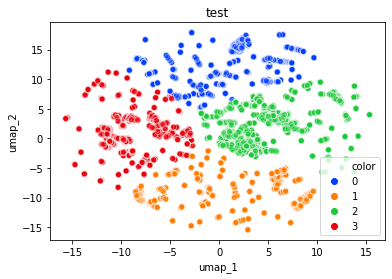

In [150]:
# Mordred all db umap
with warnings.catch_warnings(record=True):
    action_with_warnings()
    x = master(data_df, dfs, True, False, False,
               'umap', 'all', 'test', 4, 'kmeans', 'scatter')

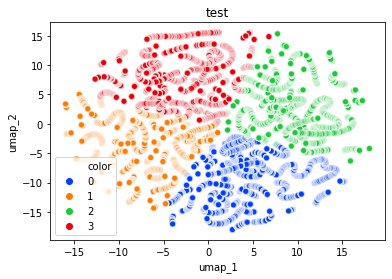

In [151]:
# Mord/Morg all db umap
with warnings.catch_warnings(record=True):
    action_with_warnings()
    x = master(data_df, dfs, True, True, False,
               'umap', 'all', 'test', 4, 'kmeans', 'scatter')

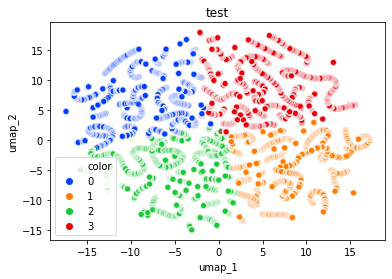

In [152]:
# Mord/Morg exptl only umap 
with warnings.catch_warnings(record=True):
    action_with_warnings()
    x = master(data_df, dfs, True, True, True,
               'umap', 'all', 'test', 4, 'kmeans', 'scatter')

In [164]:
# Mord/Morg all db color = exptl umap 
with warnings.catch_warnings(record=True):
    action_with_warnings()
    x = master(data_df, dfs, True, True, False,
               'pca', 'all', 'test', 0, 'experimental', 'scatter')

                  x            y     index       ABC     ABCGG     nAcid  \
0     -25193.583130  5696.429453       0.0  0.031189  0.044526  0.166667   
1     -25192.533785  5695.481323       1.0  0.033851  0.047172  0.166667   
2     -25191.484457  5694.533185       2.0  0.022639  0.036101  0.083333   
3     -25190.435065  5693.584874       3.0  0.065231  0.080665  0.083333   
4     -25189.385723  5692.636695       4.0  0.065231  0.080665  0.083333   
...             ...          ...       ...       ...       ...       ...   
13925  89385.149531 -2438.680860  114020.0  0.036773  0.051959  0.083333   
13926  89425.148867 -2437.654659  114060.0  0.074103  0.091555  0.083333   
13927  89426.198185 -2438.602642  114061.0  0.026577  0.038575  0.083333   
13928  89427.247528 -2439.550723  114062.0  0.049778  0.069432  0.083333   
13929  89464.250721 -2438.676384  114099.0  0.035233  0.052700  0.000000   

          nBase   SpAbs_A   SpMax_A  SpDiam_A  ...  1014  1015  1016  1017  \
0      0.

AttributeError: 'DataFrame' object has no attribute 'hmdb_ids'

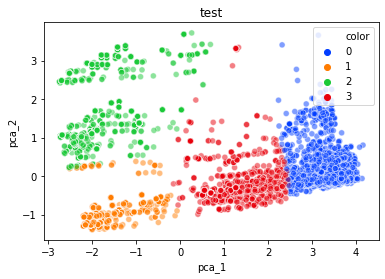

In [153]:
# Morgan all db pca
with warnings.catch_warnings(record=True):
    action_with_warnings()
    x = master(data_df, dfs, False, True, False,
               'pca', 'all', 'test', 4, 'kmeans', 'scatter')

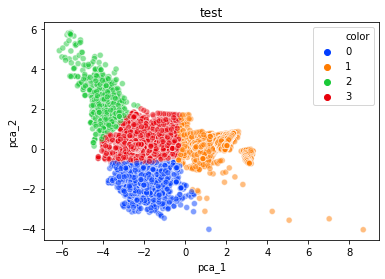

In [154]:
# Mordred all db pca
with warnings.catch_warnings(record=True):
    action_with_warnings()
    x = master(data_df, dfs, True, False, False,
               'pca', 'all', 'test', 4, 'kmeans', 'scatter')

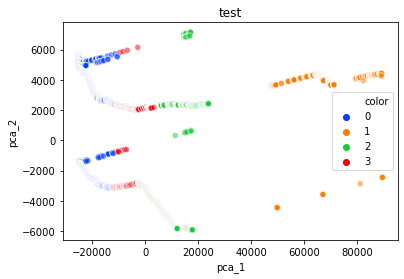

In [155]:
# Mord/Morg all pca
with warnings.catch_warnings(record=True):
    action_with_warnings()
    x = master(data_df, dfs, True, True, False,
               'pca', 'all', 'test', 4, 'kmeans', 'scatter')

In [156]:
# By FT/Orbi and pos/neg:
with warnings.catch_warnings(record=True):
    action_with_warnings()
    x = master(data_df, dfs, False, True, True,
               None, '4x', 'test', 0, 'kmeans', 'none')

In [131]:
x['data_df'].iloc[:,:9].round(2)

fourX has_no_loss        has_H2O        off_sample         \
                          count   freq   count   freq      count   freq   
0     FTICRnegative        8717   4361    8717   5702       4027   3310   
1     FTICRpositive       52636  28135   52636  30509      28135  26211   
2  Orbitrapnegative       17700  10587   17700   9604      10206   7201   
3  Orbitrappositive       30772  16870   30772  20566      13768  10314   

  off_sample_H2O         
           count   freq  
0           5447   4288  
1          30509  29339  
2           9183   4900  
3          19598  10242

In [133]:
x['data_df'].iloc[:,9:-2].round(2)

msm       msm_H2O         fdr       fdr_H2O       intensity_avg  \
   mean   std    mean   std  mean   std    mean   std          mean   
0  0.46  0.24    0.19  0.23  0.07  0.02    0.34  0.19    2408728.86   
1  0.63  0.20    0.33  0.27  0.07  0.03    0.31  0.19    5795491.96   
2  0.42  0.26    0.22  0.24  0.08  0.03    0.30  0.19       1391.38   
3  0.46  0.24    0.20  0.23  0.08  0.02    0.32  0.19      18507.02   

               intensity_avg_H2O             colocalization_H2O        \
           std              mean         std               mean   std   
0  12538905.77        1008303.16  5964492.43               0.08  0.24   
1  13229705.48        1874852.10  7330920.35               0.06  0.21   
2     17655.06            766.06     7742.89               0.08  0.23   
3    602657.46           3886.52   118583.90               0.05  0.18   

  loss_intensity_share_H2O       FDR10-v4  
                      mean   std     mean  
0                     0.56  0.47   256.06  
1                     0.50  0.48   174.08  
2                     0.46  0.47   163.75  
3                     0.59  0.47   204.16

In [134]:
# By group:
with warnings.catch_warnings(record=True):
    action_with_warnings()
    x = master(data_df, dfs, False, True, True,
               None, 'group', 'test', 0, 'kmeans', 'none')

In [135]:
x['data_df'].iloc[:,:9].round(2)

group has_no_loss        has_H2O        off_sample         \
                      count   freq   count   freq      count   freq   
0          HMGU        1042    610    1042    719        432    384   
1          IBMP        9457   4737    9457   5933       4720   4622   
2    MPI Bremen        8287   5467    8287   6924       2710   1875   
3          PNNL        4467   2623    4467   3169       1844   1805   
4  U Copenhagen        2863   1758    2863   1769       1758   1466   
5   U Melbourne        9260   4715    9260   5919       4386   3592   
6    U Rennes 1       37127  20780   37127  20471      20780  19118   
7         UTHSA       19685  12470   19685  10458      12270  10414   
8        ♡EMBL♡       17637  10196   17637  12250       7236   3760   

  off_sample_H2O         
           count   freq  
0            719    608  
1           5933   5756  
2           6431   3526  
3           3169   2936  
4           1769   1150  
5           5664   4505  
6          20471  19822  
7           9127   6853  
8          11454   7220

In [136]:
x['data_df'].iloc[:,9:-2].round(2)

msm       msm_H2O         fdr       fdr_H2O       intensity_avg  \
   mean   std    mean   std  mean   std    mean   std          mean   
0  0.29  0.23    0.10  0.15  0.07  0.02    0.37  0.18    3458377.10   
1  0.57  0.19    0.24  0.21  0.08  0.02    0.34  0.17    2623206.41   
2  0.38  0.24    0.12  0.18  0.08  0.02    0.36  0.18       1165.16   
3  0.67  0.19    0.28  0.27  0.07  0.03    0.37  0.17    6749024.23   
4  0.59  0.18    0.26  0.24  0.08  0.03    0.37  0.17       1565.06   
5  0.49  0.24    0.22  0.24  0.07  0.02    0.34  0.19    2001990.06   
6  0.64  0.19    0.36  0.28  0.07  0.02    0.28  0.19    6630820.60   
7  0.45  0.25    0.30  0.26  0.08  0.02    0.27  0.18      19999.47   
8  0.42  0.25    0.18  0.22  0.07  0.02    0.31  0.19       2228.82   

               intensity_avg_H2O             colocalization_H2O        \
           std              mean         std               mean   std   
0  29778431.84         827614.70  3740045.90               0.09  0.26   
1   4893564.72        1015253.97  4183296.63               0.08  0.22   
2      6306.07            520.06     6251.27               0.08  0.23   
3  20129056.76        1346394.13  5988999.84               0.08  0.25   
4      4834.88            497.90     1352.39               0.12  0.27   
5   8124890.93         922311.77  5732406.70               0.08  0.22   
6  13825539.46        2276623.72  8299429.63               0.06  0.20   
7    636260.60           7745.58   176807.83               0.04  0.16   
8     22862.14            925.49     8210.63               0.06  0.21   

  loss_intensity_share_H2O       FDR10-v4  
                      mean   std     mean  
0                     0.63  0.46   138.65  
1                     0.54  0.48   102.69  
2                     0.73  0.40   265.62  
3                     0.62  0.47   144.12  
4                     0.47  0.45   145.42  
5                     0.55  0.47   247.64  
6                     0.47  0.48   197.77  
7                     0.41  0.47   144.82  
8                     0.63  0.46   210.50

In [137]:
with warnings.catch_warnings(record=True):
    action_with_warnings()
    x = master(data_df, dfs, False, True, True,
               None, 'experiment', 'test', 0, 'kmeans', 'none')

In [138]:
x['data_df'].iloc[:,:9].round(2)

ds_id has_no_loss      has_H2O      off_sample         \
                                count freq   count freq      count   freq   
0    2016-09-22_11h16m11s         213  129     213  124        129  126.0   
1    2016-09-22_11h16m15s         423  327     423  279        327  190.0   
2    2016-09-22_11h16m16s         221  130     221  123        130  127.0   
3    2016-09-22_11h16m23s         284  208     284  185        208  179.0   
4    2016-09-22_11h16m27s         316  229     316  210        229  190.0   
..                    ...         ...  ...     ...  ...        ...    ...   
313  2019-10-29_21h29m01s         222  169     222  152        169  141.0   
314  2019-10-29_21h37m26s         201  150     201  133        150  124.0   
315  2019-11-15_20h49m52s         215  149     215  127        149  125.0   
316  2019-11-15_20h55m40s         236  177     236  157        177  153.0   
317  2019-12-04_00h41m47s         768  614     768  696        154  153.0   

    off_sample_H2O         
             count   freq  
0               89   86.0  
1              144   74.0  
2               98   95.0  
3               99   74.0  
4              106   89.0  
..             ...    ...  
313             70   54.0  
314             68   50.0  
315             88   70.0  
316             79   65.0  
317            696  693.0  

[318 rows x 9 columns]

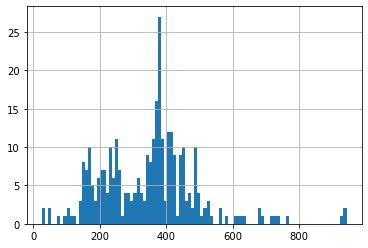

In [148]:
x['data_df'].iloc[:,1].hist(bins=100)

In [139]:
x['data_df'].iloc[:,9:-2].round(2)

msm       msm_H2O         fdr       fdr_H2O       intensity_avg  \
     mean   std    mean   std  mean   std    mean   std          mean   
0    0.62  0.21    0.42  0.30  0.08  0.02    0.28  0.19   10073913.50   
1    0.37  0.29    0.25  0.27  0.07  0.02    0.19  0.15    2003149.38   
2    0.61  0.23    0.38  0.31  0.08  0.02    0.31  0.19    9065291.12   
3    0.30  0.30    0.23  0.29  0.07  0.02    0.22  0.19    2826383.14   
4    0.30  0.31    0.22  0.29  0.07  0.02    0.22  0.16    2273307.25   
..    ...   ...     ...   ...   ...   ...     ...   ...           ...   
313  0.38  0.29    0.24  0.23  0.07  0.02    0.29  0.19          3.35   
314  0.36  0.28    0.26  0.25  0.08  0.03    0.20  0.11          3.17   
315  0.39  0.26    0.21  0.24  0.08  0.02    0.33  0.17          3.27   
316  0.40  0.26    0.25  0.23  0.08  0.03    0.27  0.16          3.18   
317  0.73  0.18    0.15  0.22  0.07  0.02    0.42  0.14    5993992.19   

                 intensity_avg_H2O              colocalization_H2O        \
             std              mean          std               mean   std   
0    20756500.05        8725065.28  21963716.25               0.02  0.12   
1     4653028.27        1393794.65   4094618.73               0.04  0.16   
2    18678174.53        6350004.54  17242979.84               0.02  0.12   
3     8201378.78        2479995.89   8268812.14               0.04  0.17   
4     5951937.78        2123649.23   6388083.09               0.04  0.17   
..           ...               ...          ...                ...   ...   
313        10.64              5.35        32.65               0.03  0.15   
314         7.11              2.28         4.45               0.04  0.19   
315         7.06              1.45         2.01               0.04  0.16   
316         7.01              1.58         2.31               0.03  0.13   
317  11788096.09         676761.03    940699.18               0.06  0.22   

    loss_intensity_share_H2O       FDR10-v4  
                        mean   std     mean  
0                       0.41  0.49    114.0  
1                       0.26  0.42    358.0  
2                       0.43  0.49    101.0  
3                       0.29  0.44    233.0  
4                       0.29  0.44    221.0  
..                       ...   ...      ...  
313                     0.27  0.43    189.0  
314                     0.29  0.44    105.0  
315                     0.35  0.46    102.0  
316                     0.28  0.43    111.0  
317                     0.83  0.35    160.0  

[318 rows x 17 columns]

In [193]:
df = data_df[['has_no_loss', 'has_H2O', 'fdr', 'fdr_H2O']]
df = df.groupby(['has_no_loss', 'has_H2O']).count()
df

fdr  fdr_H2O
has_no_loss has_H2O                 
False       True          0    52845
True        False    112721        0
            True      31003    31003